# DCGAN PyTorch

### Import Libraries

In [1]:
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.optim as optim
from torch.utils.data import TensorDataset, DataLoader, random_split
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# Set random seed for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)
torch.use_deterministic_algorithms(True) # Needed for reproducible results

Random Seed:  999


### Hyperparameters

In [ ]:
# Number of workers for dataloader
workers = 2

# Batch size during training
batch_size = 16

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
z_dim = 256

# Number of training epochs
num_epochs = 20

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

### Loading dataset

In [3]:

import kagglehub

# Download latest version
path = kagglehub.dataset_download("ebrahimelgazar/pixel-art")
print("Path to dataset files:", path)

labels_path = os.path.join(path, "sprites_labels.npy")
data_path = os.path.join(path, "sprites.npy")

# Load dataset
labels = np.load(labels_path)
data = np.load(data_path)

print("Shape: ", data.shape)
print("Shape: ", data.shape)

images_tensor = torch.tensor(data, dtype=torch.float32)
labels_tensor = torch.tensor(labels, dtype=torch.float32)

# Convert HWC -> CHW
print("Shape (before permute): ", images_tensor.shape)
images_tensor = images_tensor.permute(0, 3, 1, 2)
print("Shape (after permute): ", images_tensor.shape)

dataset = TensorDataset(images_tensor, labels_tensor)
loader = DataLoader(dataset, batch_size=batch_size, shuffle=True, num_workers=workers)

device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

print("Device: ", device)

c:\Users\ASUS\torch-gpu\.venv\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Path to dataset files: C:\Users\ASUS\.cache\kagglehub\datasets\ebrahimelgazar\pixel-art\versions\1
Shape:  (89400, 16, 16, 3)
Shape:  (89400, 16, 16, 3)
Shape (before permute):  torch.Size([89400, 16, 16, 3])
Shape (after permute):  torch.Size([89400, 3, 16, 16])
Device:  cuda:0


In [4]:
import matplotlib.pyplot as plt
import torchvision.utils as vutils
import torch

# Get one batch from the DataLoader
real_batch = next(iter(loader))  # real_batch[0]: images, real_batch[1]: labels

images, labels = real_batch
print(images.shape, labels.shape)

torch.Size([16, 3, 16, 16]) torch.Size([16, 5])


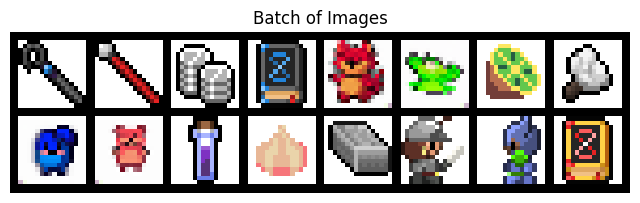

In [5]:
grid = vutils.make_grid(
    images,
    padding=2,
    normalize=True
)

'''
C: channels
H: height
W: width
B: batch size
'''
# CHW -> HWC for matplotlib
grid = grid.permute(1, 2, 0)

plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Batch of Images")
plt.imshow(grid.numpy())
plt.show()

### Weights initialization

In [6]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)   
        nn.init.constant_(m.bias.data, 0)

### Deeper Generator

In [7]:
# Size of feature maps in generator
ngf = 64

class DeeperGenerator(nn.Module):
    def __init__(self, ngpu):
        super(DeeperGenerator, self).__init__()
        self.ngpu = ngpu
        self.gen = nn.Sequential(
            # LAYER 1: The "Foundation" Layer
            # Input: (z_dim) x 1 x 1
            # Output: (ngf * 8) x 2 x 2
            nn.ConvTranspose2d(
                in_channels = z_dim,
                out_channels = ngf * 8,
                kernel_size = 2,  # Changed from 4 to 2
                stride = 1,
                padding = 0,
                bias = False
            ),
            nn.BatchNorm2d(num_features = ngf * 8),
            nn.LeakyReLU(0.2, inplace = True),
            
            # LAYER 2: First Upsample (NEW!)
            # Input: (ngf * 8) x 2 x 2
            # Output: (ngf * 4) x 4 x 4
            nn.ConvTranspose2d(
                in_channels = ngf * 8,
                out_channels = ngf * 4,
                kernel_size = 4,
                stride = 2,
                padding = 1,
                bias = False
            ),
            nn.BatchNorm2d(num_features = ngf * 4),
            nn.LeakyReLU(0.2, inplace = True),
            
            # LAYER 3: Second Upsample
            # Input: (ngf * 4) x 4 x 4
            # Output: (ngf * 2) x 8 x 8
            nn.ConvTranspose2d(
                in_channels = ngf * 4,
                out_channels = ngf * 2,
                kernel_size = 4,
                stride = 2,
                padding = 1,
                bias = False
            ),
            nn.BatchNorm2d(num_features = ngf * 2),
            nn.LeakyReLU(0.2, inplace = True),
            nn.Dropout2d(0.3),
            
            # LAYER 4: Final Upsample to 16x16 Sprite
            # Input: (ngf * 2) x 8 x 8
            # Output: (nc) x 16 x 16
            nn.ConvTranspose2d(
                in_channels = ngf * 2,
                out_channels = nc,
                kernel_size = 4,
                stride = 2,
                padding = 1,
                bias = False
            ),
            nn.Tanh()
        )
    
    def forward(self, x):
        return self.gen(x)

In [8]:
# Create the generator
netG = DeeperGenerator(ngpu).to(device)

# Handle multi-GPU if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the ``weights_init`` function to randomly initialize all weights
#  to ``mean=0``, ``stdev=0.02``.
netG.apply(weights_init)

# Print the model
print(netG)

DeeperGenerator(
  (gen): Sequential(
    (0): ConvTranspose2d(128, 512, kernel_size=(2, 2), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2, inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): LeakyReLU(negative_slope=0.2, inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): LeakyReLU(negative_slope=0.2, inplace=True)
    (9): Dropout2d(p=0.3, inplace=False)
    (10): ConvTranspose2d(128, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (11): Tanh()
  )
)


### Deeper Discriminator

In [9]:
# Size of feature maps in discriminator
ndf = 64

class DeeperDiscriminator(nn.Module):
    def __init__(self, ngpu):
        super(DeeperDiscriminator, self).__init__()
        self.disc = nn.Sequential(
            
            # --- LAYER 1: THE INPUT LAYER ---
            # Input: (nc) x 16 x 16
            # Output: (ndf) x 8 x 8
            nn.Conv2d(
                in_channels  = nc,
                out_channels = ndf,
                kernel_size  = 4,
                stride       = 2, # Halves the dimension
                padding      = 1,
                bias         = False
            ),
            # Note: No BatchNorm in the first layer of the Discriminator (DCGAN rule)
            nn.LeakyReLU(0.2, inplace=True),

            # --- LAYER 2: THE COMPRESSION LAYER ---
            # Input: (ndf) x 8 x 8
            # Output: (ndf * 2) x 4 x 4
            nn.Conv2d(
                in_channels  = ndf,
                out_channels = ndf * 2,
                kernel_size  = 4,
                stride       = 2, # Halves the dimension
                padding      = 1,
                bias         = False
            ),
            nn.BatchNorm2d(num_features = ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),

            # --- LAYER 3: THE DEEPER COMPRESSION LAYER (NEW!) ---
            # Input: (ndf * 2) x 4 x 4
            # Output: (ndf * 4) x 2 x 2
            nn.Conv2d(
                in_channels  = ndf * 2,
                out_channels = ndf * 4,
                kernel_size  = 4,
                stride       = 2, # Halves the dimension
                padding      = 1,
                bias         = False
            ),
            nn.BatchNorm2d(num_features = ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Dropout2d(0.3), # Optional: Add dropout to prevent overfitting

            # --- LAYER 4: THE CLASSIFICATION LAYER ---
            # Input: (ndf * 4) x 2 x 2
            # Output: 1 x 1 x 1 (A single probability score)
            nn.Conv2d(
                in_channels  = ndf * 4,
                out_channels = 1,
                kernel_size  = 2, # Changed from 4 to 2 since input is now 2x2
                stride       = 1,
                padding      = 0,
                bias         = False
            ),
            nn.Sigmoid() # Outputs a value between 0 (Fake) and 1 (Real)
        )

    def forward(self, x):
        return self.disc(x)

In [10]:
# Create the Discriminator
netD = DeeperDiscriminator(ngpu).to(device)

# Handle multi-GPU if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the ``weights_init`` function to randomly initialize all weights
# like this: ``to mean=0, stdev=0.2``.
netD.apply(weights_init)

# Print the model
print(netD)

DeeperDiscriminator(
  (disc): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Dropout2d(p=0.3, inplace=False)
    (9): Conv2d(256, 1, kernel_size=(2, 2), stride=(1, 1), bias=False)
    (10): Sigmoid()
  )
)


### Loss Function and Optimizers

In [11]:
# Learning rate for optimizers
lrD = 1e-6
lrG = 3e-6

# Beta1 hyperparameter for Adam optimizers
beta1 = 0.5

# Initialize the ``BCELoss`` function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, z_dim, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lrD, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lrG, betas=(beta1, 0.999))

### Training Loop 

In [12]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(loader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, z_dim, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch, accumulated (summed) with previous gradients
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Compute error of D as sum over the fake and the real batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(loader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(loader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting Training Loop...
[0/20][0/5588]	Loss_D: 1.5040	Loss_G: 0.7348	D(x): 0.4557	D(G(z)): 0.4887 / 0.4990
[0/20][50/5588]	Loss_D: 1.6415	Loss_G: 0.5683	D(x): 0.5103	D(G(z)): 0.5904 / 0.5760
[0/20][100/5588]	Loss_D: 1.7406	Loss_G: 0.4611	D(x): 0.5216	D(G(z)): 0.6510 / 0.6387
[0/20][150/5588]	Loss_D: 1.6199	Loss_G: 0.4413	D(x): 0.6187	D(G(z)): 0.6599 / 0.6505
[0/20][200/5588]	Loss_D: 1.7311	Loss_G: 0.3936	D(x): 0.6222	D(G(z)): 0.6825 / 0.6874
[0/20][250/5588]	Loss_D: 1.7618	Loss_G: 0.3657	D(x): 0.6235	D(G(z)): 0.6993 / 0.7041
[0/20][300/5588]	Loss_D: 1.8044	Loss_G: 0.3702	D(x): 0.6418	D(G(z)): 0.7293 / 0.6985
[0/20][350/5588]	Loss_D: 1.7985	Loss_G: 0.3567	D(x): 0.6388	D(G(z)): 0.7243 / 0.7030
[0/20][400/5588]	Loss_D: 1.5850	Loss_G: 0.3745	D(x): 0.6954	D(G(z)): 0.6851 / 0.6950
[0/20][450/5588]	Loss_D: 1.6727	Loss_G: 0.4137	D(x): 0.6488	D(G(z)): 0.6932 / 0.6762
[0/20][500/5588]	Loss_D: 1.4389	Loss_G: 0.4246	D(x): 0.6728	D(G(z)): 0.6238 / 0.6583
[0/20][550/5588]	Loss_D: 1.3987	Loss_G: 0.

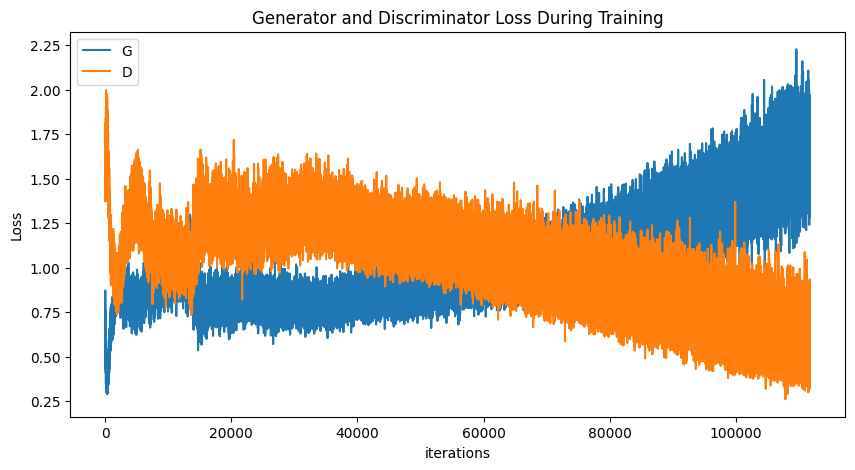

In [13]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

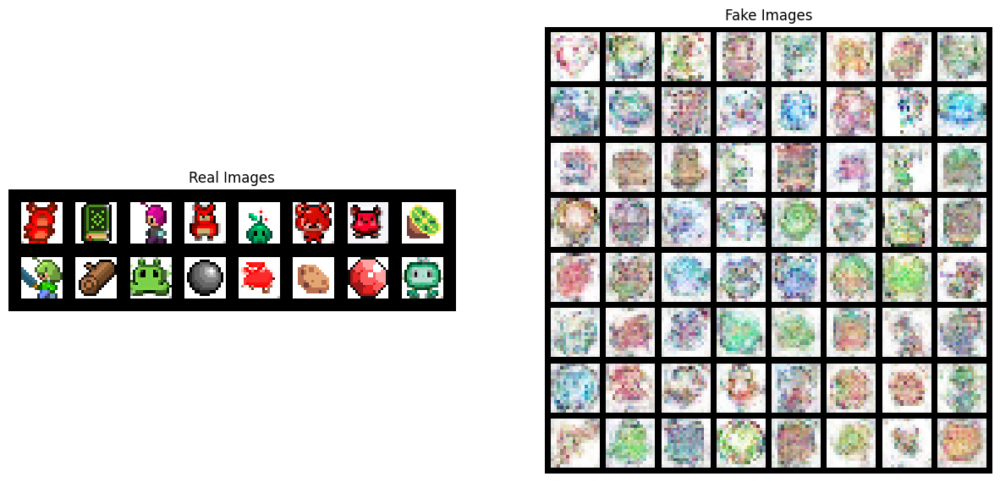

In [14]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(loader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()

Animation size has reached 20989439 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


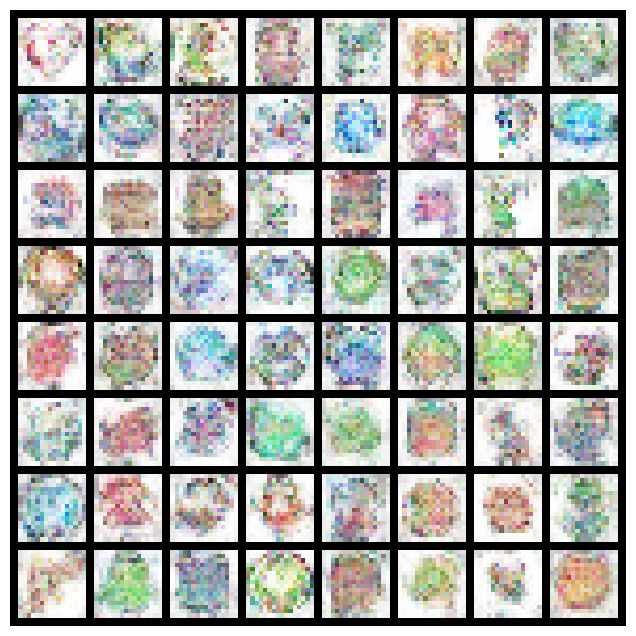

In [15]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

In [16]:
torch.manual_seed(42)

N = len(dataset)
n_train = int(0.8 * N)
n_test  = N - n_train

eval_train_set, eval_test_set = random_split(dataset, [n_train, n_test])


eval_train_loader = DataLoader(eval_train_set, batch_size=batch_size, shuffle=True,  num_workers=workers, pin_memory=True)
eval_test_loader  = DataLoader(eval_test_set,  batch_size=batch_size, shuffle=False, num_workers=workers, pin_memory=True)

print("Train/Test:", len(eval_train_set), len(eval_test_set))
print("Train/Test:", (len(eval_train_set)/(len(eval_train_set)+len(eval_test_set))), (len(eval_test_loader))/(len(eval_test_loader)+len(eval_train_loader)))


Train/Test: 71520 17880
Train/Test: 0.8 0.20007158196134575


In [17]:
torch.manual_seed(42)
g = torch.Generator().manual_seed(42)

N = len(dataset)
n_train = int(0.8 * N)
n_test  = N - n_train

eval_train_set, eval_test_set = random_split(dataset, [n_train, n_test], generator=g)

eval_train_loader = DataLoader(eval_train_set, batch_size=batch_size, shuffle=True,  num_workers=workers, pin_memory=True)
eval_test_loader  = DataLoader(eval_test_set,  batch_size=batch_size, shuffle=False, num_workers=workers, pin_memory=True)

print("Train/Test:", len(eval_train_set), len(eval_test_set))
print("Ratio:", len(eval_train_set)/N, len(eval_test_set)/N)

Train/Test: 71520 17880
Ratio: 0.8 0.2


In [18]:
netD.eval()
for p in netD.parameters():
    p.requires_grad = False

@torch.no_grad()
def get_scores_real(loader):
    scores, labels = [], []
    for imgs, y in loader:
        imgs = imgs.to(device)

        s = netD(imgs)
        s = s.view(s.size(0), -1).mean(dim=1)  # (N,)
        scores.append(s.cpu().numpy())
        labels.append(y.cpu().numpy())
    return np.concatenate(scores), np.concatenate(labels)

@torch.no_grad()
def get_scores_fake(netG, n_samples, batch_size=128, nz=z_dim):
    scores = []
    netG.eval()
    for i in range(0, n_samples, batch_size):
        cur = min(batch_size, n_samples - i)
        z = torch.randn(cur, nz, 1, 1, device=device)
        fake = netG(z)
        s = netD(fake)
        s = s.view(s.size(0), -1).mean(dim=1)
        scores.append(s.cpu().numpy())
    return np.concatenate(scores)

real_scores, real_labels = get_scores_real(eval_test_loader)
fake_scores = get_scores_fake(netG, n_samples=len(real_scores), batch_size=batch_size, nz=z_dim)

print(real_scores.shape, fake_scores.shape)
print("Real mean/std:", real_scores.mean(), real_scores.std())
print("Fake mean/std:", fake_scores.mean(), fake_scores.std())


(17880,) (17880,)
Real mean/std: 0.012965736 0.051530987
Fake mean/std: 0.6805691 0.0015801099


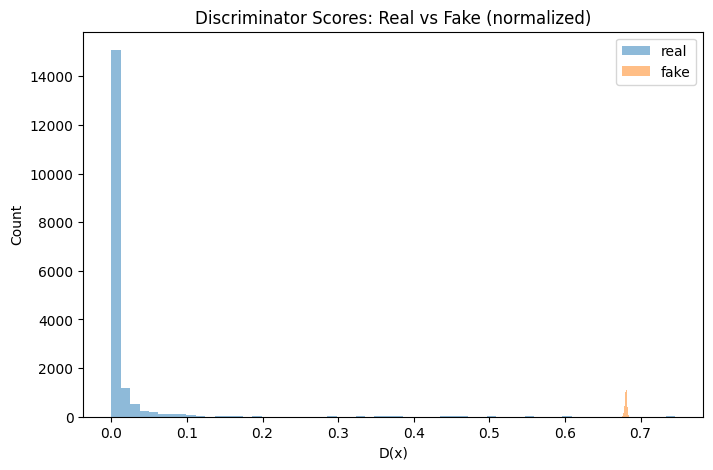

In [19]:
plt.figure(figsize=(8,5))
plt.hist(real_scores, bins=60, alpha=0.5, label="real")
plt.hist(fake_scores, bins=60, alpha=0.5, label="fake")
plt.title("Discriminator Scores: Real vs Fake (normalized)")
plt.xlabel("D(x)")
plt.ylabel("Count")
plt.legend()
plt.show()


In [20]:
def cohens_d(a, b):
    a = np.asarray(a); b = np.asarray(b)
    na, nb = len(a), len(b)
    sa, sb = a.var(ddof=1), b.var(ddof=1)
    s = np.sqrt(((na-1)*sa + (nb-1)*sb) / (na+nb-2))
    return (a.mean() - b.mean()) / (s + 1e-12)

print("Real mean/std:", real_scores.mean(), real_scores.std())
print("Fake mean/std:", fake_scores.mean(), fake_scores.std())
print("Cohen's d (real - fake):", cohens_d(real_scores, fake_scores))


Real mean/std: 0.012965736 0.051530987
Fake mean/std: 0.6805691 0.0015801099
Cohen's d (real - fake): -18.312551


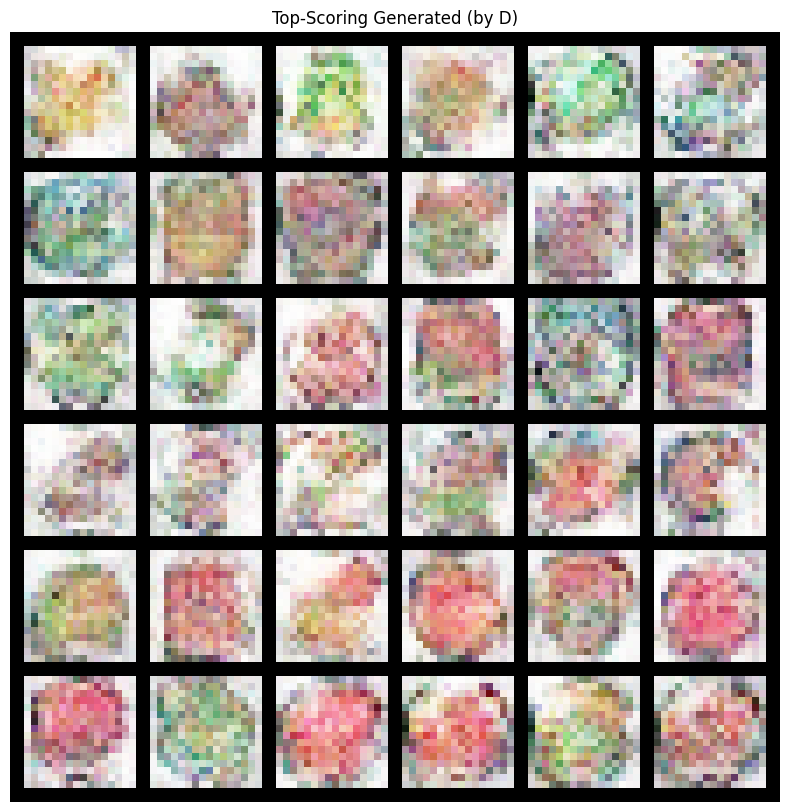

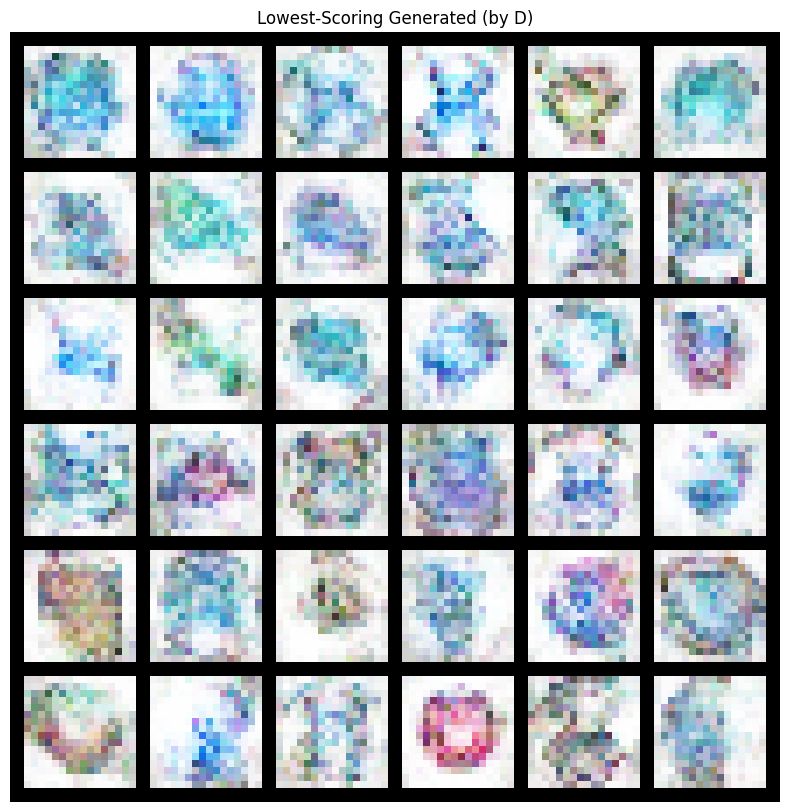

Best score range: 0.68284726 to 0.68582386
Worst score range: 0.6751549 to 0.6782464


In [21]:
@torch.no_grad()
def sample_fake_with_scores(netG, n=512, nz=z_dim):
    z = torch.randn(n, nz, 1, 1, device=device)
    fake = netG(z)
    s = netD(fake).view(n, -1).mean(dim=1).cpu().numpy()
    return fake.cpu(), s

fake_imgs, fake_s = sample_fake_with_scores(netG, n=512, nz=z_dim)

best_idx  = np.argsort(fake_s)[-36:]
worst_idx = np.argsort(fake_s)[:36]

grid_best  = vutils.make_grid(fake_imgs[best_idx],  nrow=6, normalize=True)
grid_worst = vutils.make_grid(fake_imgs[worst_idx], nrow=6, normalize=True)

plt.figure(figsize=(10,10))
plt.imshow(np.transpose(grid_best.numpy(), (1,2,0)))
plt.axis("off")
plt.title("Top-Scoring Generated (by D)")
plt.show()

plt.figure(figsize=(10,10))
plt.imshow(np.transpose(grid_worst.numpy(), (1,2,0)))
plt.axis("off")
plt.title("Lowest-Scoring Generated (by D)")
plt.show()

print("Best score range:", fake_s[best_idx].min(), "to", fake_s[best_idx].max())
print("Worst score range:", fake_s[worst_idx].min(), "to", fake_s[worst_idx].max())
